# tutoriall
- https://satijalab.org/seurat/articles/spatial_vignette.html#slide-seq-1
- https://nbisweden.github.io/workshop-scRNAseq/labs/compiled/seurat/seurat_07_spatial.html

# packages

In [4]:
# devtools::install_github('satijalab/seurat-data')

In [2]:
library(Seurat)
library(SeuratData)
library(ggplot2)
library(patchwork)
library(dplyr)

In [58]:
# install.packages("hdf5r")

# load data
- read in hdf5 file in outs folder

In [2]:
# ?Load10X_Spatial

In [3]:
data_dir = "cellranger/10XSpatial_Vcl/EVSE220525-VclCN-A1-1_report/outs"
visium_A <- Load10X_Spatial(data.dir = data_dir, slice = "A1")
visium_A <- SCTransform(visium_A, assay = "Spatial", verbose = FALSE)

In [4]:
data_dir = "cellranger/10XSpatial_Vcl/EVSE220525-VclCN-B1-1_report/outs"
visium_B <- Load10X_Spatial(data.dir = data_dir, slice = "B1")
visium_B <- SCTransform(visium_B, assay = "Spatial", verbose = FALSE)

In [5]:
data_dir = "cellranger/10XSpatial_Vcl/EVSE220525-VclMT-C1-1_report/outs"
visium_C <- Load10X_Spatial(data.dir = data_dir, slice = "C1")
visium_C <- SCTransform(visium_C, assay = "Spatial", verbose = FALSE)

In [6]:
data_dir = "cellranger/10XSpatial_Vcl/EVSE220525-VclMT-D1-1_report/outs"
visium_D <- Load10X_Spatial(data.dir = data_dir, slice = "D1")
visium_D <- SCTransform(visium_D, assay = "Spatial", verbose = FALSE)

## save individual

In [7]:
visium_A$orig.ident <- "A1"
visium_B$orig.ident <- "B1"
visium_C$orig.ident <- "C1"
visium_D$orig.ident <- "D1"

In [247]:
# save(visium_A, visium_B, visium_C, visium_D, file = "keyRdata/all.seurat.Rdata")

In [8]:
save(visium_A, visium_B, visium_C, visium_D, file = "keyRdata/all.seurat.GFP.Rdata")

## merge control

In [114]:
# InstallData("stxBrain")

In [115]:
# brain1 <- LoadData("stxBrain", type = "anterior1")

In [185]:
# brain1@images$anterior1@coordinates

In [9]:
visium.merge_AB <- merge(visium_A, visium_B)

Warning message in CheckDuplicateCellNames(object.list = objects):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [10]:
visium.merge_AB <- PercentageFeatureSet(visium.merge_AB, "^mt-", col.name = "percent_mito")
visium.merge_AB <- PercentageFeatureSet(visium.merge_AB, "^Hb.*-", col.name = "percent_hb")

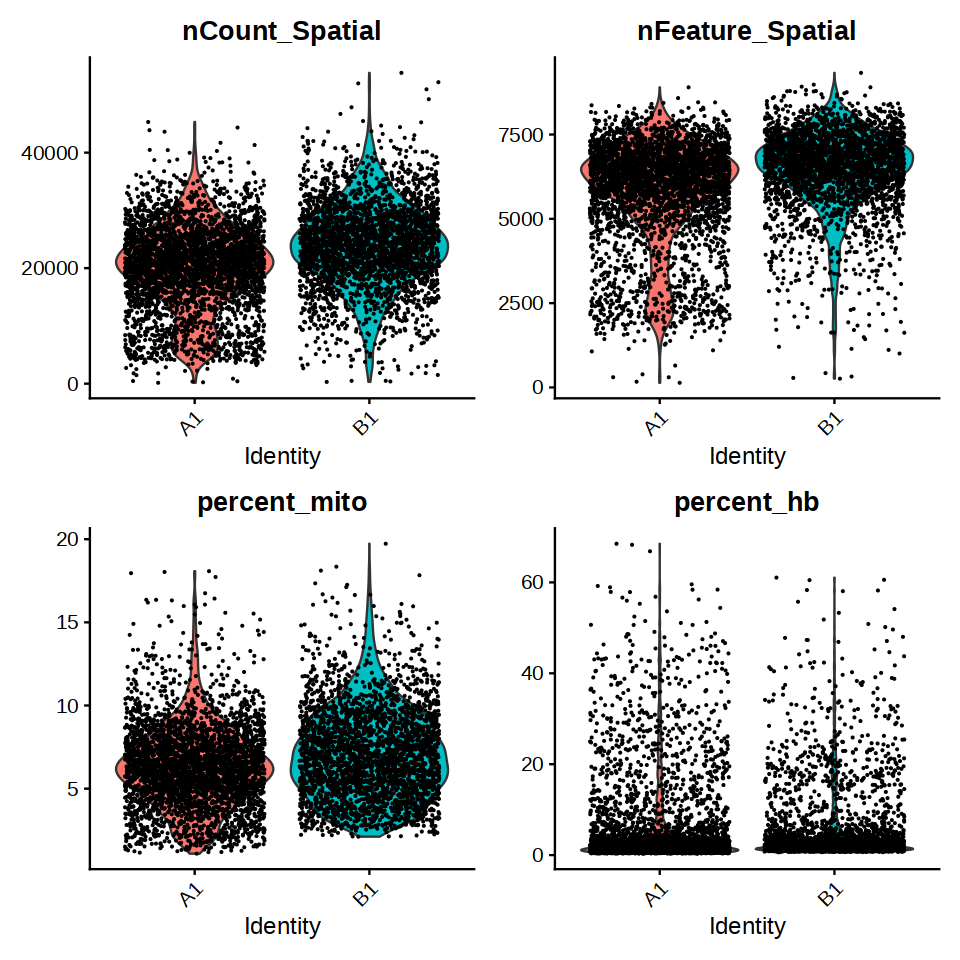

In [13]:
options(repr.plot.width=8, repr.plot.height=8)
VlnPlot(visium.merge_AB, group.by = "orig.ident", features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito",
    "percent_hb"), pt.size = 0.1, ncol = 2) + NoLegend()

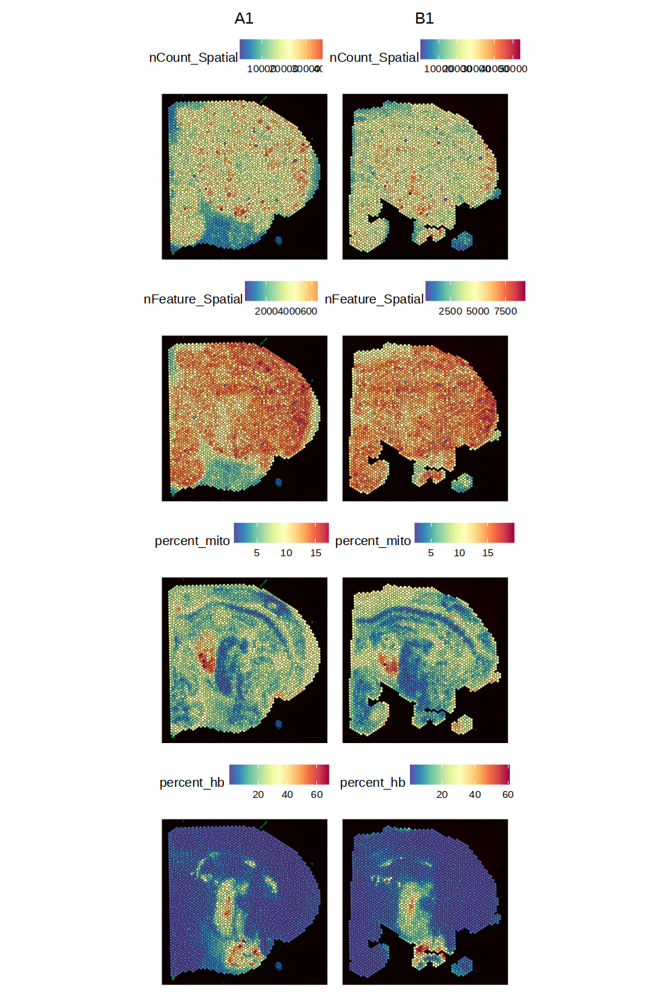

In [14]:
options(repr.plot.width=8, repr.plot.height=12)
SpatialFeaturePlot(visium.merge_AB, features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito", "percent_hb"))

In [15]:
visium.merge_AB

An object of class Seurat 
51829 features across 6532 samples within 2 assays 
Active assay: SCT (19543 features, 0 variable features)
 1 other assay present: Spatial
 2 images present: A1, B1

In [16]:
visium.merge_AB = visium.merge_AB[, visium.merge_AB$nCount_Spatial > 10000 & visium.merge_AB$nFeature_Spatial > 2000]

In [17]:
visium.merge_AB

An object of class Seurat 
51829 features across 6001 samples within 2 assays 
Active assay: SCT (19543 features, 0 variable features)
 1 other assay present: Spatial
 2 images present: A1, B1

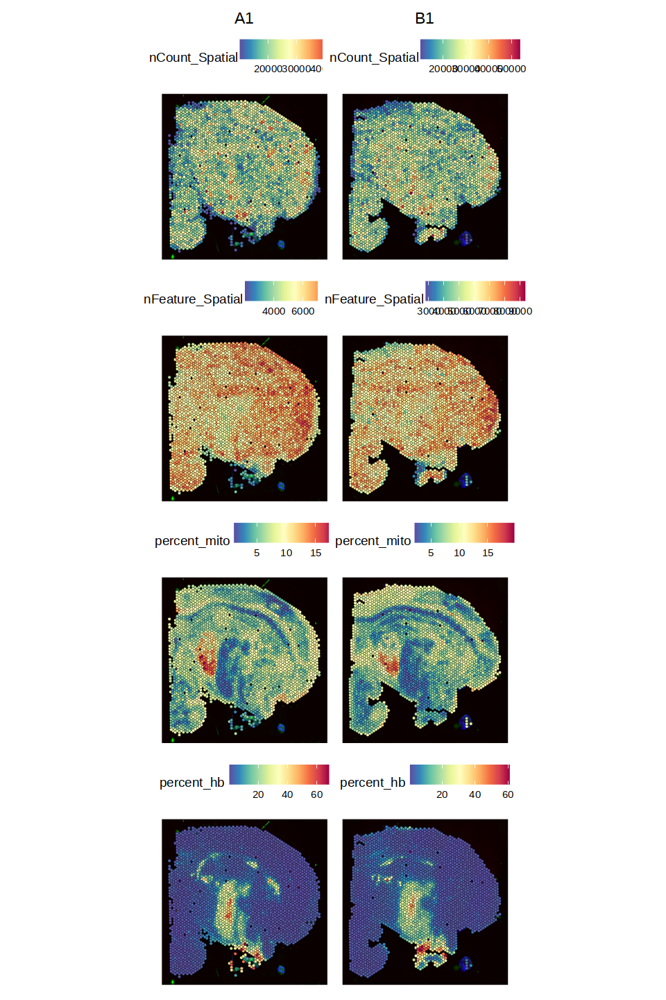

In [18]:
options(repr.plot.width=8, repr.plot.height=12)
SpatialFeaturePlot(visium.merge_AB, features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito", "percent_hb"))

In [19]:
DefaultAssay(visium.merge_AB) <- "SCT"
VariableFeatures(visium.merge_AB) <- c(VariableFeatures(visium_A), VariableFeatures(visium_B))
visium.merge_AB <- RunPCA(visium.merge_AB, verbose = FALSE)
visium.merge_AB <- FindNeighbors(visium.merge_AB, dims = 1:30)
visium.merge_AB <- FindClusters(visium.merge_AB, verbose = FALSE)
visium.merge_AB <- RunUMAP(visium.merge_AB, dims = 1:30)

Computing nearest neighbor graph

Computing SNN

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
21:55:53 UMAP embedding parameters a = 0.9922 b = 1.112

21:55:53 Read 6001 rows and found 30 numeric columns

21:55:53 Using Annoy for neighbor search, n_neighbors = 30

21:55:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:55:53 Writing NN index file to temp file /tmp/pbs.1198654.omics/Rtmp7Wbfxa/file45de73984a5b

21:55:53 Searching Annoy index using 1 thread, search_k = 3000

21:55:55 Annoy recall = 100%

21:55:56 Commencing smooth

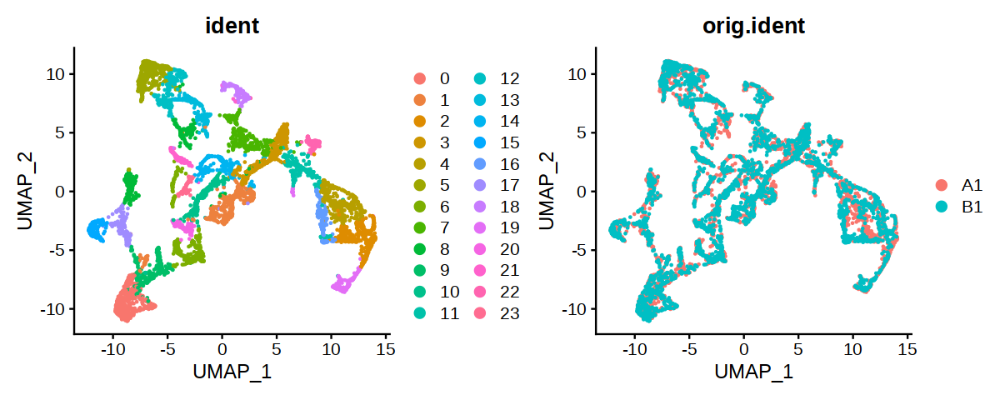

In [20]:
options(repr.plot.width=10, repr.plot.height=4)
DimPlot(visium.merge_AB, reduction = "umap", group.by = c("ident", "orig.ident"))

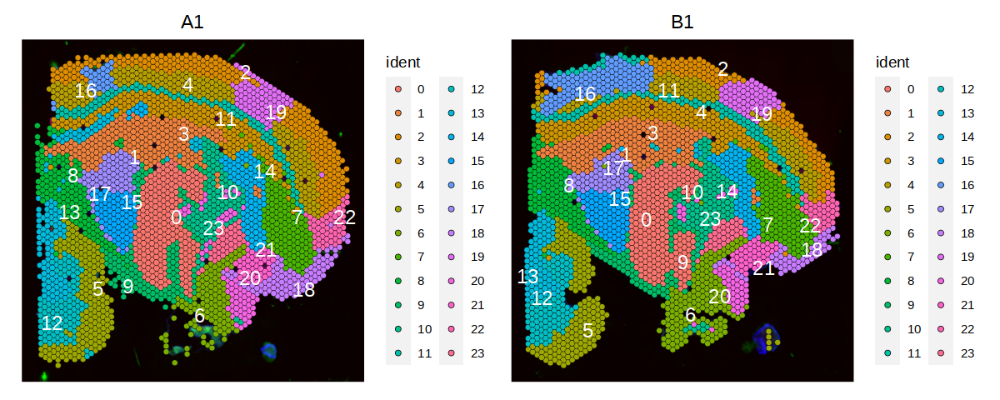

In [21]:
SpatialDimPlot(visium.merge_AB, label = TRUE, label.size = 5, label.box = F, repel = T)

### heart subset

In [23]:
visium.merge_AB.heart <- subset(visium.merge_AB, idents = c(15, 17))

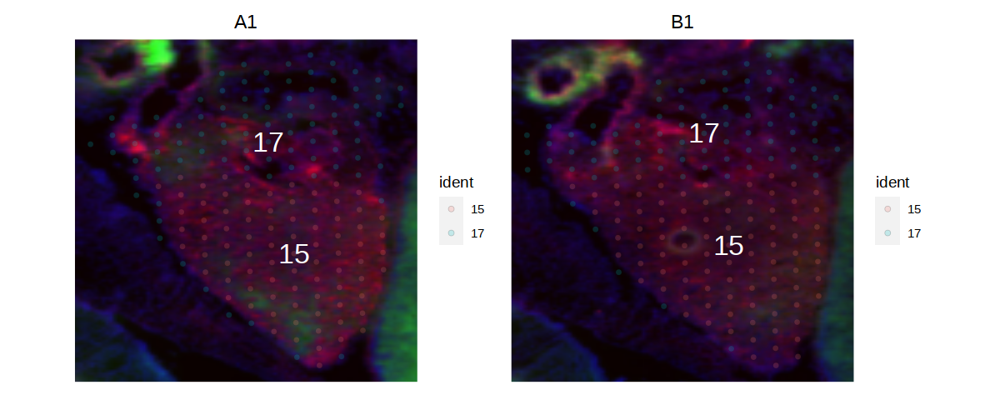

In [24]:
SpatialDimPlot(visium.merge_AB.heart, crop = TRUE, label = TRUE, alpha = 0.2, label.box = F)

In [25]:
save(visium.merge_AB, visium.merge_AB.heart, file = "keyRdata/visium.merge_AB.control.Rdata")

## merge mutant

In [26]:
visium.merge_CD <- merge(visium_C, visium_D)

Warning message in CheckDuplicateCellNames(object.list = objects):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [27]:
visium.merge_CD <- PercentageFeatureSet(visium.merge_CD, "^mt-", col.name = "percent_mito")
visium.merge_CD <- PercentageFeatureSet(visium.merge_CD, "^Hb.*-", col.name = "percent_hb")

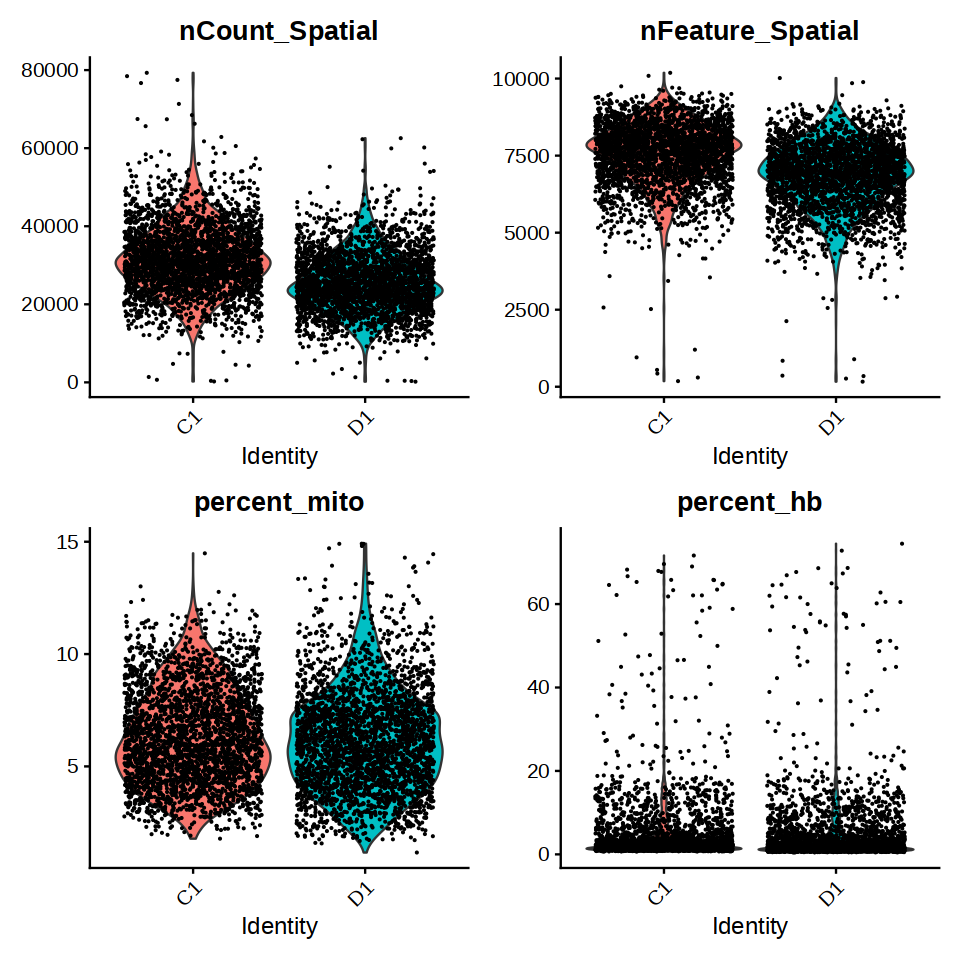

In [28]:
options(repr.plot.width=8, repr.plot.height=8)
VlnPlot(visium.merge_CD, group.by = "orig.ident", features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito",
    "percent_hb"), pt.size = 0.1, ncol = 2) + NoLegend()

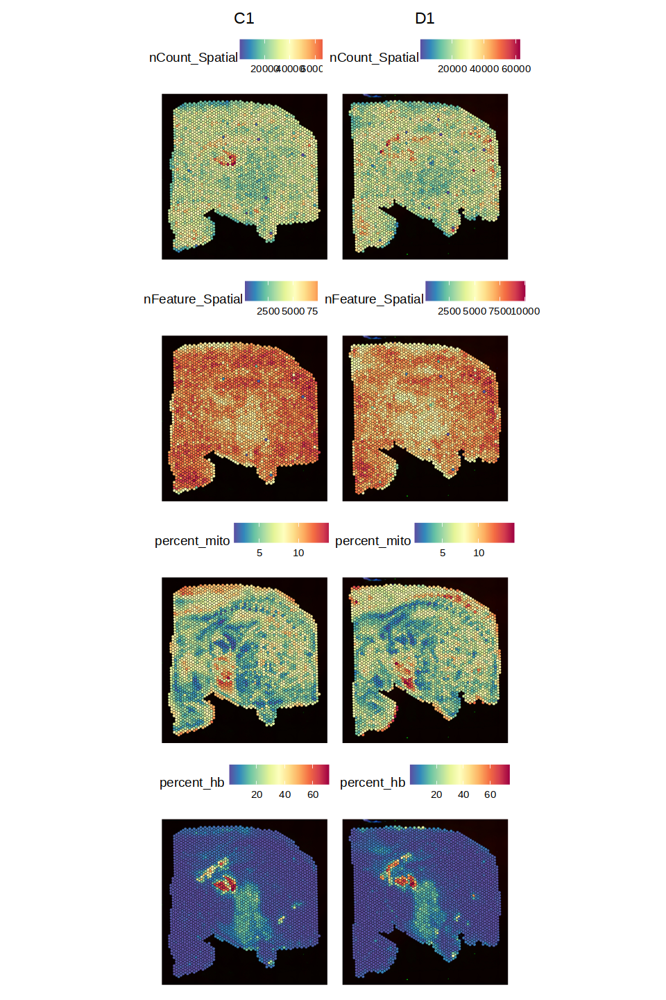

In [29]:
options(repr.plot.width=8, repr.plot.height=12)
SpatialFeaturePlot(visium.merge_CD, features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito", "percent_hb"))

In [30]:
visium.merge_CD

An object of class Seurat 
52246 features across 5961 samples within 2 assays 
Active assay: SCT (19960 features, 0 variable features)
 1 other assay present: Spatial
 2 images present: C1, D1

In [31]:
visium.merge_CD = visium.merge_CD[, visium.merge_CD$nCount_Spatial > 10000 & visium.merge_CD$nFeature_Spatial > 2000]

In [32]:
visium.merge_CD

An object of class Seurat 
52246 features across 5920 samples within 2 assays 
Active assay: SCT (19960 features, 0 variable features)
 1 other assay present: Spatial
 2 images present: C1, D1

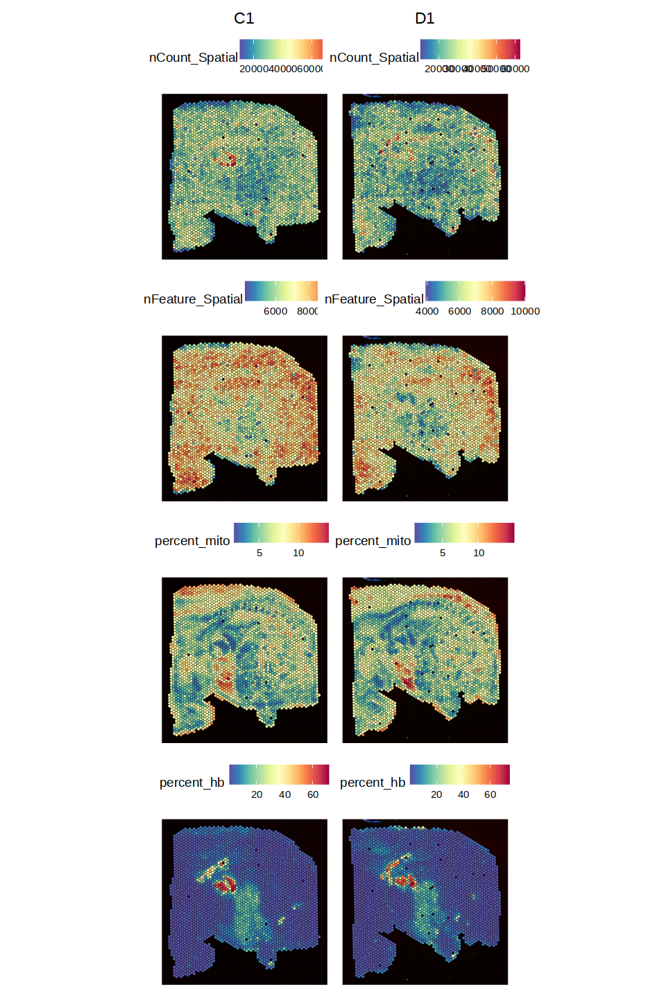

In [33]:
options(repr.plot.width=8, repr.plot.height=12)
SpatialFeaturePlot(visium.merge_CD, features = c("nCount_Spatial", "nFeature_Spatial", "percent_mito", "percent_hb"))

In [34]:
DefaultAssay(visium.merge_CD) <- "SCT"
VariableFeatures(visium.merge_CD) <- c(VariableFeatures(visium_C), VariableFeatures(visium_D))
visium.merge_CD <- RunPCA(visium.merge_CD, verbose = FALSE)
visium.merge_CD <- FindNeighbors(visium.merge_CD, dims = 1:30)
visium.merge_CD <- FindClusters(visium.merge_CD, verbose = FALSE)
visium.merge_CD <- RunUMAP(visium.merge_CD, dims = 1:30)

Computing nearest neighbor graph

Computing SNN

22:00:59 UMAP embedding parameters a = 0.9922 b = 1.112

22:00:59 Read 5920 rows and found 30 numeric columns

22:00:59 Using Annoy for neighbor search, n_neighbors = 30

22:00:59 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

22:01:00 Writing NN index file to temp file /tmp/pbs.1198654.omics/Rtmp7Wbfxa/file45de78214249

22:01:00 Searching Annoy index using 1 thread, search_k = 3000

22:01:02 Annoy recall = 100%

22:01:03 Commencing smooth kNN distance calibration using 1 thread

22:01:04 Initializing from normalized Laplacian + noise

22:01:04 Commencing optimization for 500 epochs, with 222464 positive edges

22:01:22 Optimization finished



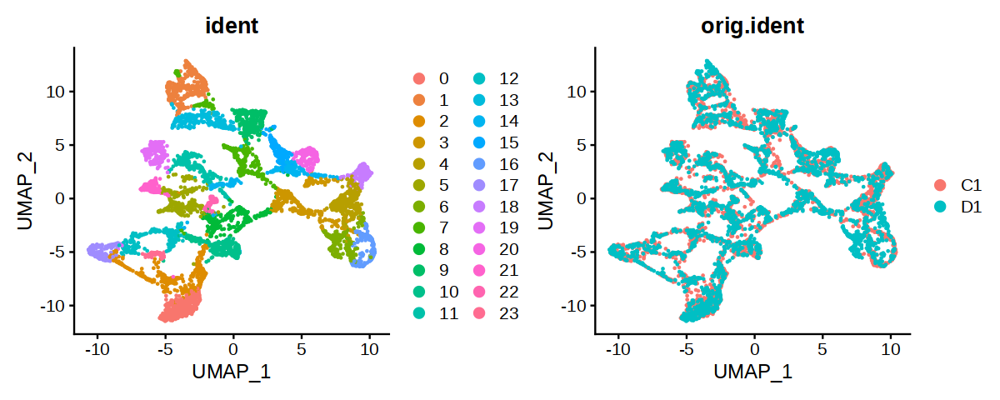

In [35]:
options(repr.plot.width=10, repr.plot.height=4)
DimPlot(visium.merge_CD, reduction = "umap", group.by = c("ident", "orig.ident"))

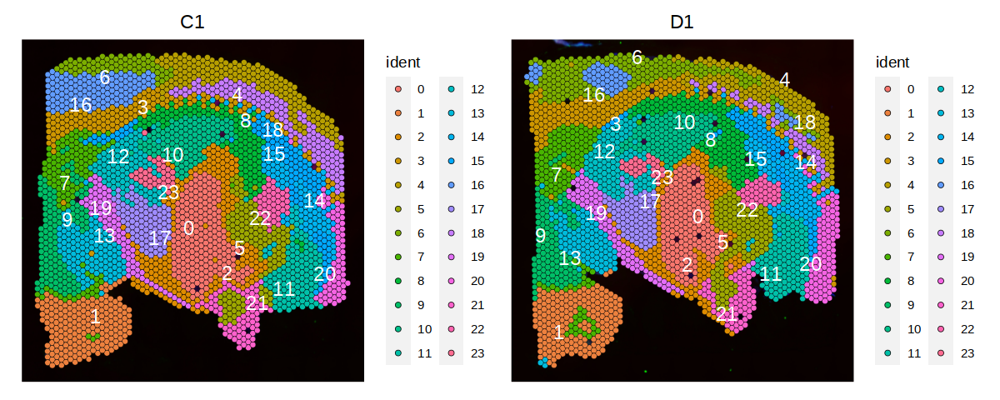

In [36]:
SpatialDimPlot(visium.merge_CD, label = TRUE, label.size = 5, label.box = F, repel = T)

### heart subset

In [37]:
visium.merge_CD.heart <- subset(visium.merge_CD, idents = c(12, 17))

In [38]:
visium.merge_CD.heart@images

$C1
Spatial data from the VisiumV1 technology for 215 samples
Associated assay: Spatial 
Image key: c1_ 

$D1
Spatial data from the VisiumV1 technology for 224 samples
Associated assay: Spatial 
Image key: d1_ 


In [39]:
# WhichCells(visium_C, expression = c1_imagerow > 400 | c1_imagecol < 150)

In [40]:
# # no use
# SpatialDimPlot(visium_C, cells.highlight = WhichCells(visium_C, expression = c1_imagerow < 7000))

In [41]:
# add coordinates to meta data
# visium.merge_CD.heart@meta.data
tmp.coord <- rbind(visium.merge_CD.heart@images$C1@coordinates, visium.merge_CD.heart@images$D1@coordinates)
# hist(tmp.coord$imagerow)
# hist(tmp.coord$imagecol)
# hist(tmp.coord$row)
# head(tmp.coord)
visium.merge_CD.heart$imagerow <- tmp.coord$imagerow
visium.merge_CD.heart$imagecol <- tmp.coord$imagecol

In [42]:
# test <- subset(visium.merge_CD.heart, imagecol < 10000)
# SpatialDimPlot(test, crop = TRUE, label = TRUE, alpha = 2, label.box = F)

In [43]:
visium.merge_CD.heart <- subset(visium.merge_CD.heart, imagecol < 10000)

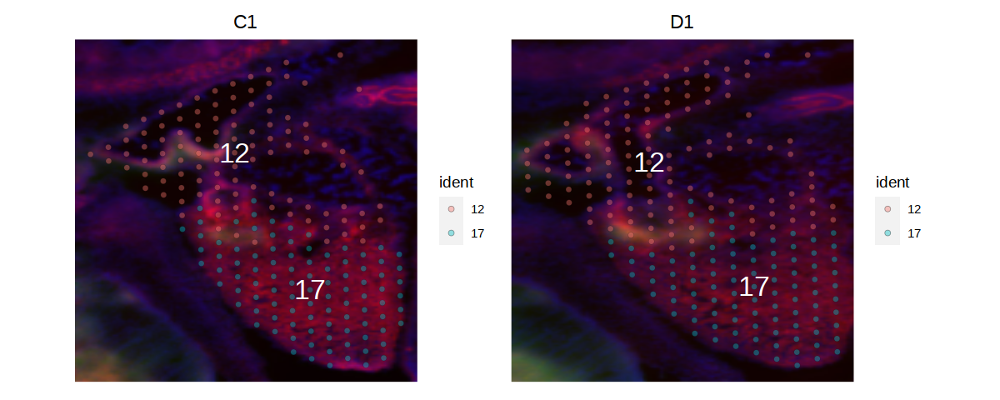

In [44]:
SpatialDimPlot(visium.merge_CD.heart, crop = TRUE, label = TRUE, alpha = 0.4, label.box = F)

In [45]:
save(visium.merge_CD, visium.merge_CD.heart, file = "keyRdata/visium.merge_CD.mutant.Rdata")

In [2]:
print(load("keyRdata/visium.merge_CD.mutant.Rdata"))

[1] "visium.merge_CD"       "visium.merge_CD.heart"


In [4]:
visium.merge_CD.heart

An object of class Seurat 
52248 features across 359 samples within 2 assays 
Active assay: SCT (19963 features, 6000 variable features)
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 2 images present: C1, D1

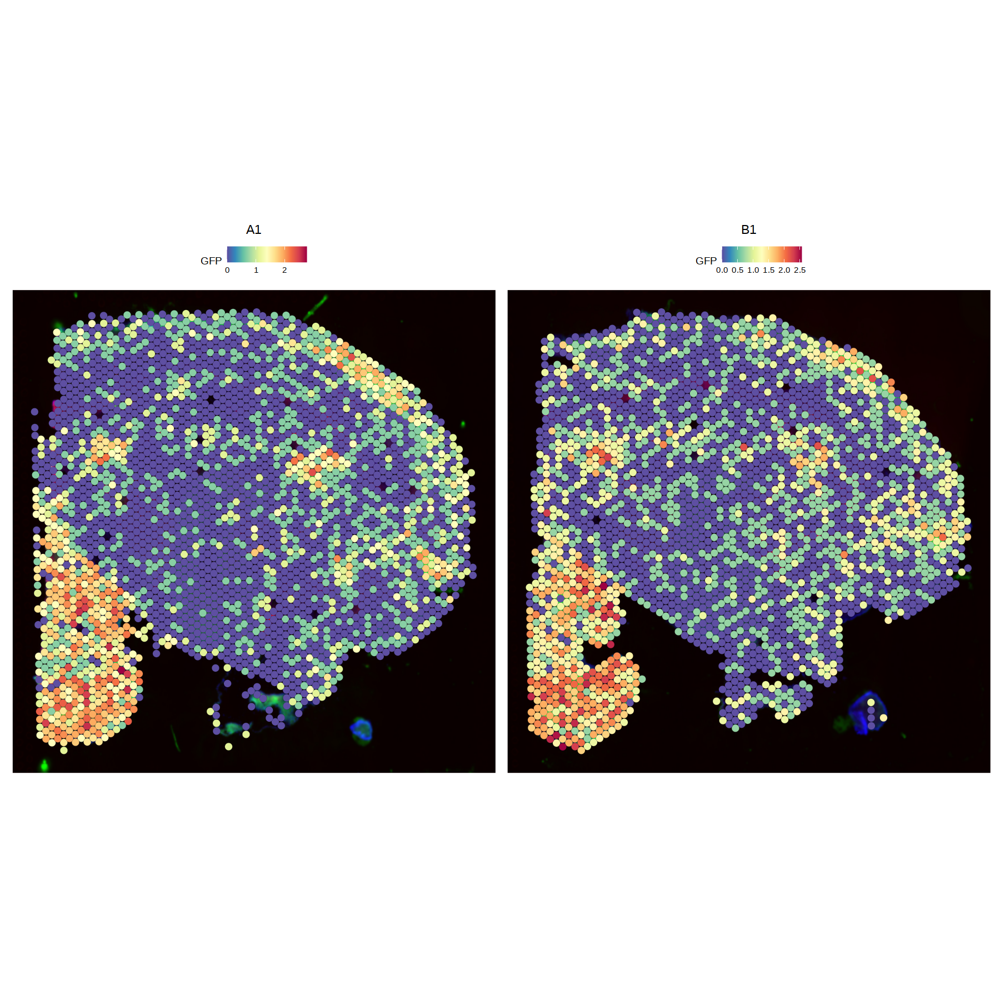

In [57]:
options(repr.plot.width=15, repr.plot.height=15)
p1 <- SpatialFeaturePlot(visium.merge_AB, features = c("GFP"), ncol = 2, alpha = 1, stroke = 0.1)
p1

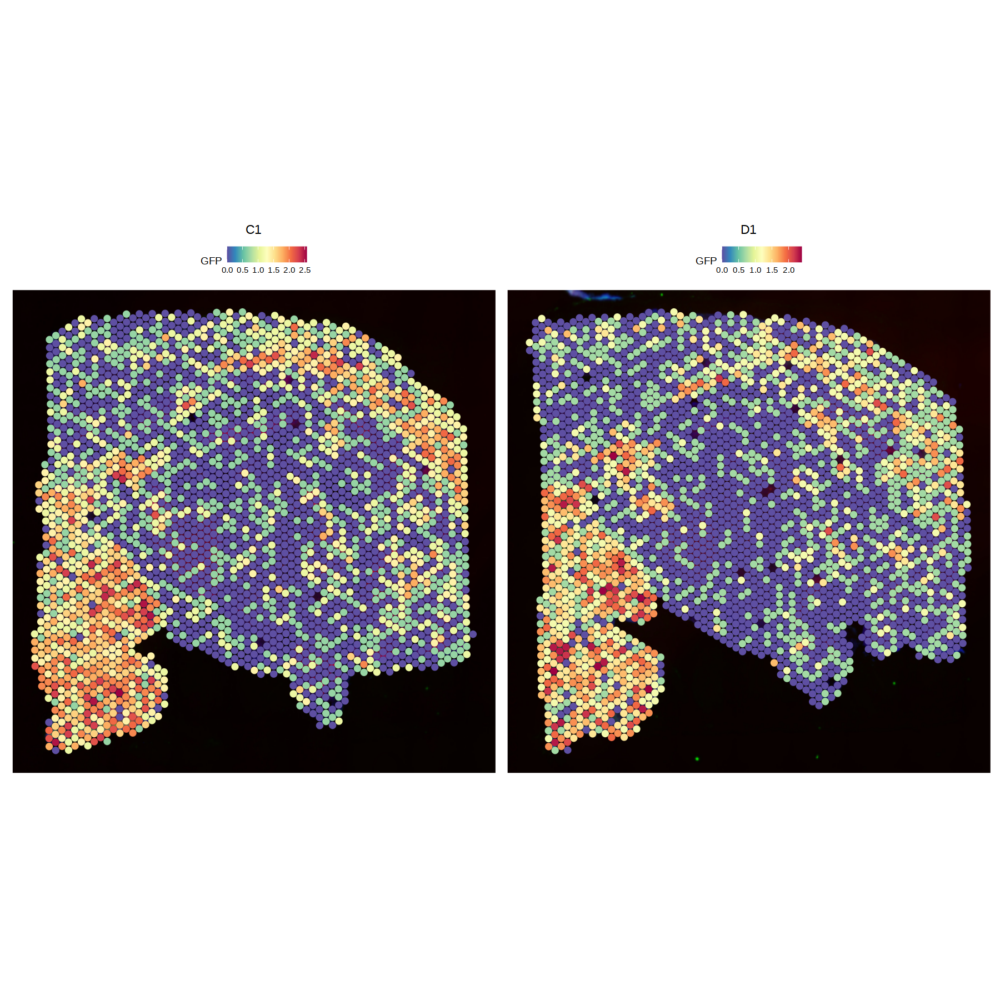

In [58]:
p2 <- SpatialFeaturePlot(visium.merge_CD, features = c("GFP"), ncol = 2, alpha = 1, stroke = 0.1)
p2

# deconvelution
- CSC paper

# other analysis

In [17]:
p1 <- VlnPlot(visium, features = "nCount_Spatial", pt.size = 0.1) + NoLegend()
p2 <- SpatialFeaturePlot(visium, features = "nCount_Spatial") + theme(legend.position = "right")

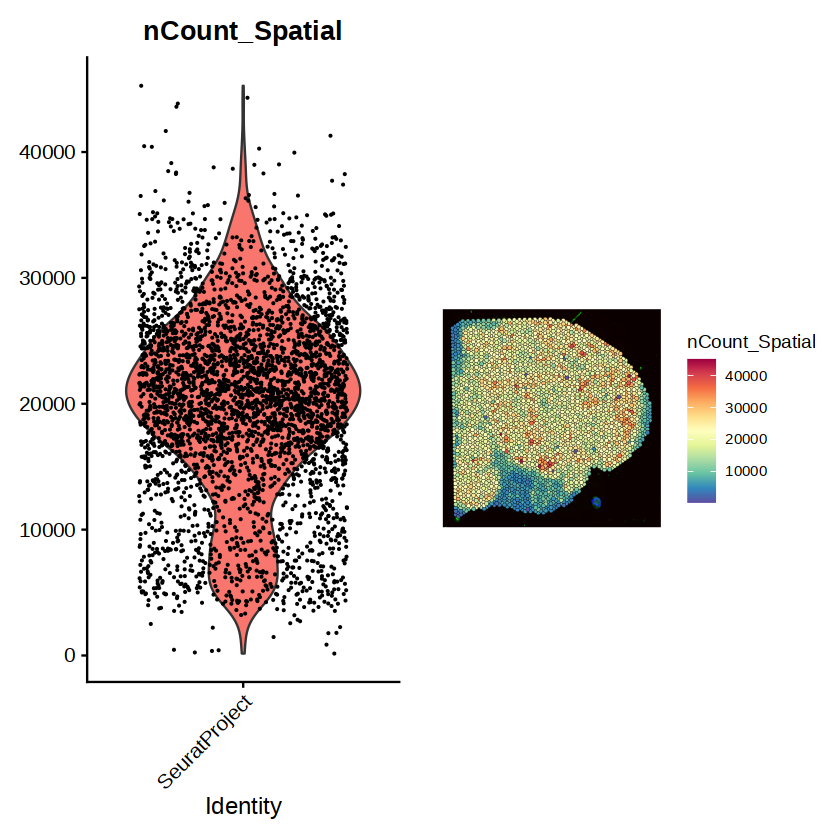

In [18]:
# wrap_plots(plot1, plot2)
cowplot::plot_grid(p1, p2)

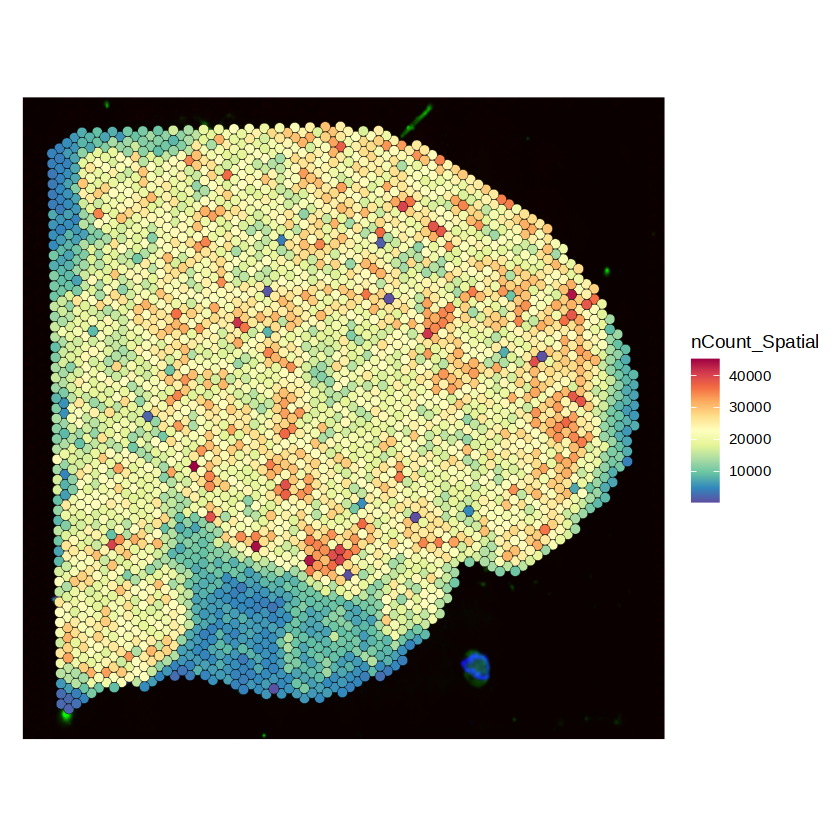

In [19]:
p2

In [20]:
visium@assays$Spatial@counts[1:5,1:5]

5 x 5 sparse Matrix of class "dgCMatrix"
        AAACAACGAATAGTTC-1 AAACAATCTACTAGCA-1 AAACACCAATAACTGC-1
Xkr4                     1                  .                  .
Gm1992                   .                  .                  .
Gm19938                  .                  .                  .
Gm37381                  .                  .                  .
Rp1                      .                  .                  .
        AAACAGAGCGACTCCT-1 AAACAGCTTTCAGAAG-1
Xkr4                     .                  .
Gm1992                   .                  .
Gm19938                  .                  .
Gm37381                  .                  .
Rp1                      .                  .

In [27]:
visium@images$slice1

Spatial data from the VisiumV1 technology for 3558 samples
Associated assay: Spatial 
Image key: slice1_ 

In [28]:
visium <- SCTransform(visium, assay = "Spatial", verbose = FALSE)

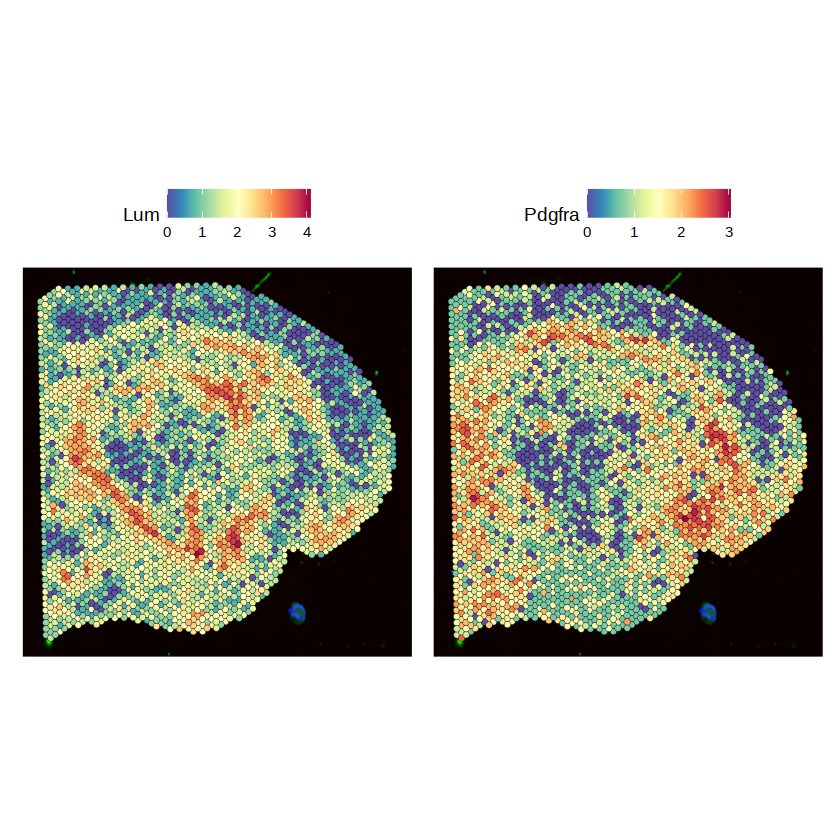

In [30]:
SpatialFeaturePlot(visium, features = c("Lum", "Pdgfra"))

In [31]:
visium <- RunPCA(visium, assay = "SCT", verbose = FALSE)
visium <- FindNeighbors(visium, reduction = "pca", dims = 1:30)
visium <- FindClusters(visium, verbose = FALSE)
visium <- RunUMAP(visium, reduction = "pca", dims = 1:30)

Computing nearest neighbor graph

Computing SNN

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:45:54 UMAP embedding parameters a = 0.9922 b = 1.112

14:45:54 Read 3558 rows and found 30 numeric columns

14:45:54 Using Annoy for neighbor search, n_neighbors = 30

14:45:54 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:45:55 Writing NN index file to temp file /tmp/pbs.1168967.omics/Rtmp8fWcZR/file2509a2ed3de48

14:45:55 Searching Annoy index using 1 thread, search_k = 3000

14:45:56 Annoy recall = 100%

14:45:56 Commencing smoot

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



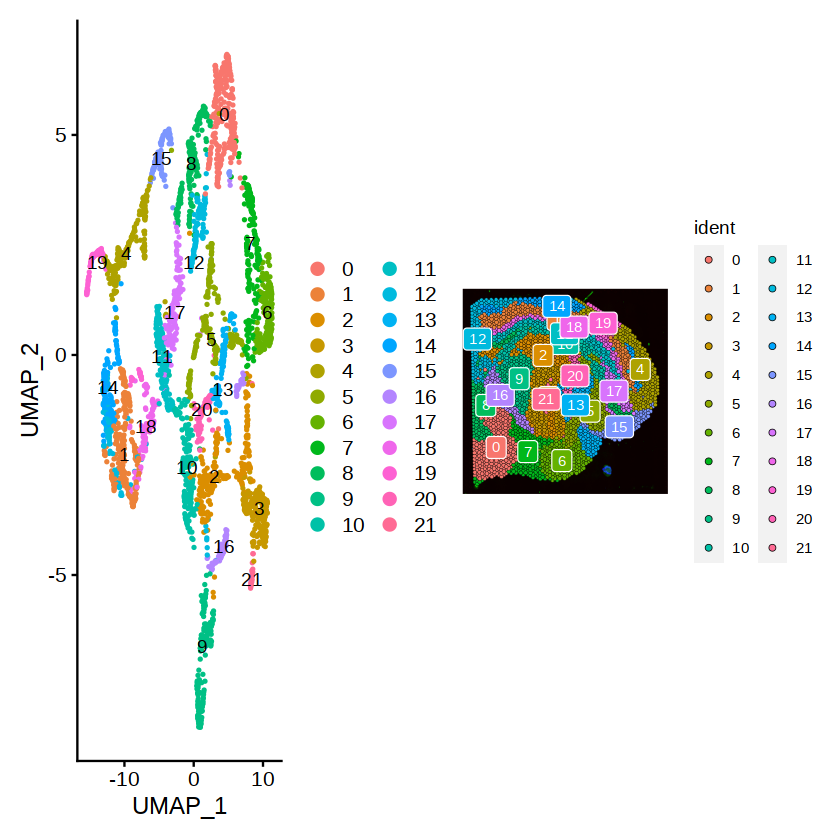

In [32]:
p1 <- DimPlot(visium, reduction = "umap", label = TRUE)
p2 <- SpatialDimPlot(visium, label = TRUE, label.size = 3)
p1 + p2

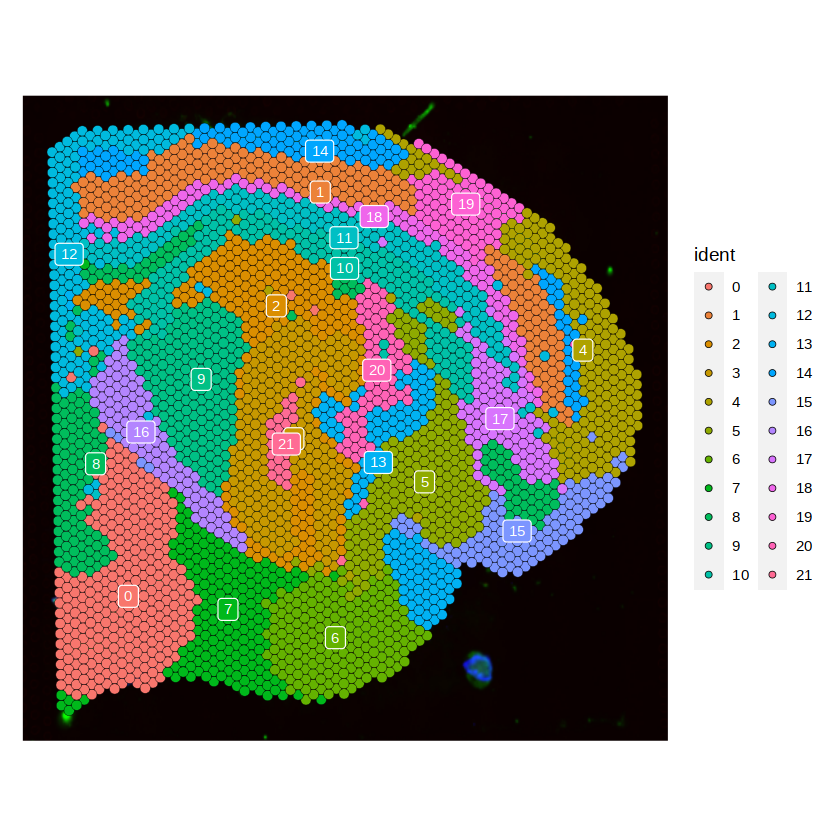

In [36]:
p2

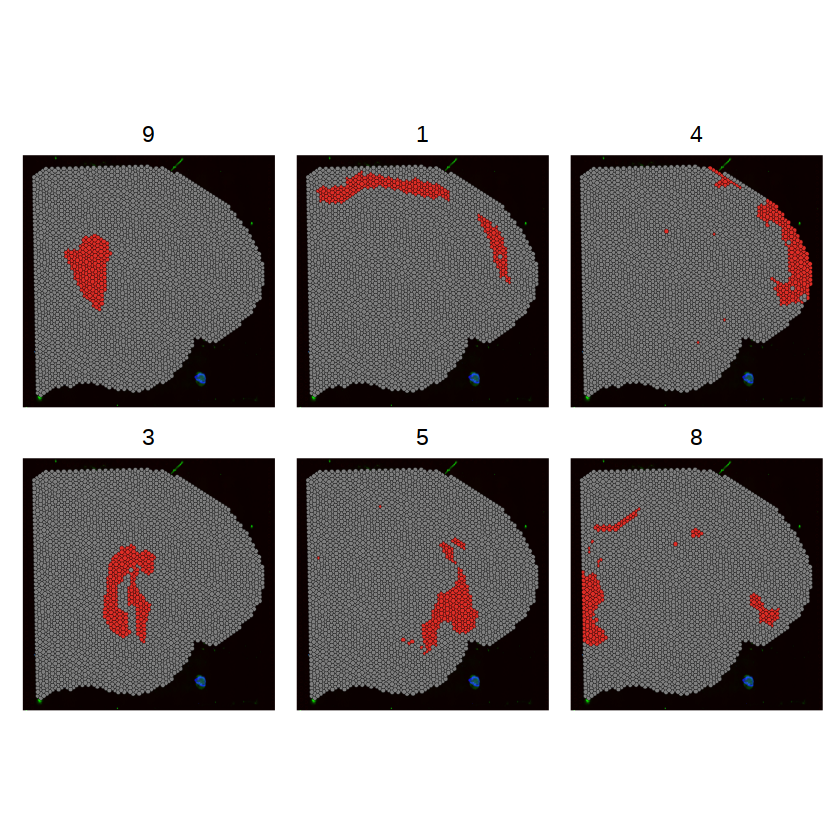

In [37]:
SpatialDimPlot(visium, cells.highlight = CellsByIdentities(object = visium, idents = c(9, 1, 4, 3,
    5, 8)), facet.highlight = TRUE, ncol = 3)

# load

In [3]:
print(load("keyRdata/visium.merge_AB.control.Rdata"))

[1] "visium.merge_AB"       "visium.merge_AB.heart"


In [4]:
tmp.genes <- c("Ret","Phox2b","Elavl4","Tubb3","Stmn2","Cartpt","Prph","Sox10","Fabp7","Plp1")

In [19]:
?SpatialFeaturePlot

In [12]:
# dir.create("Figures")

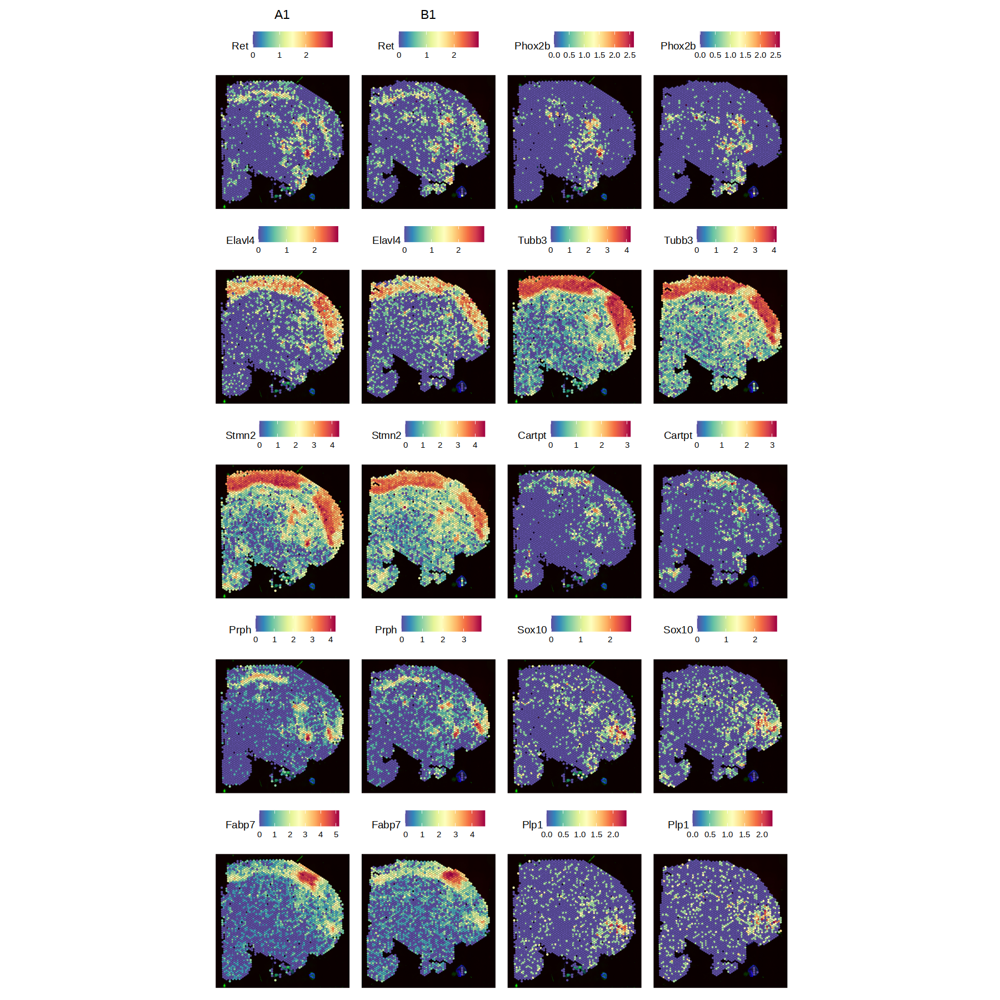

In [20]:
options(repr.plot.width=15, repr.plot.height=15)
SpatialFeaturePlot(visium.merge_AB, features = tmp.genes, ncol = 4, alpha = 1, stroke = 0.1)

In [21]:
ggsave(filename = "Figures/AB.control.key.genes.pdf", width = 15, height = 15)

In [11]:
print(load("keyRdata/visium.merge_CD.mutant.Rdata"))

[1] "visium.merge_CD"       "visium.merge_CD.heart"


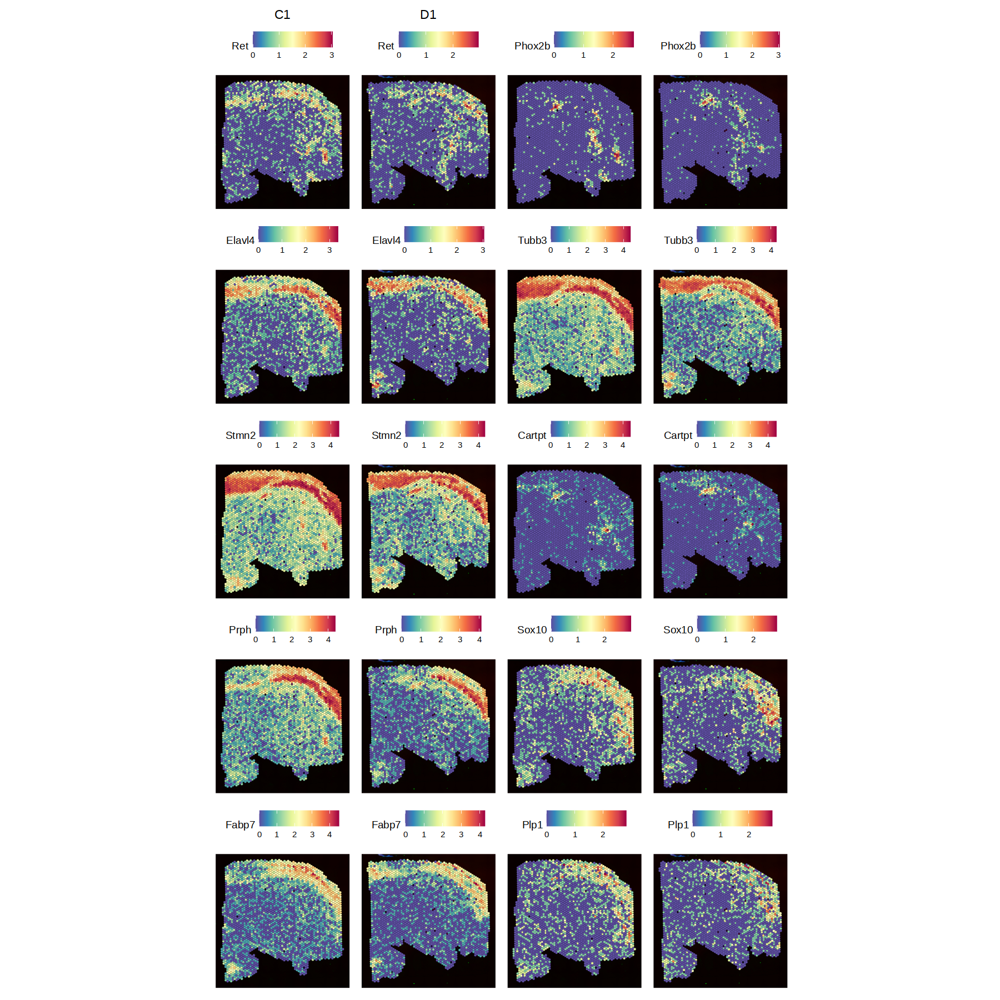

In [22]:
options(repr.plot.width=15, repr.plot.height=15)
SpatialFeaturePlot(visium.merge_CD, features = tmp.genes, ncol = 4, alpha = 1, stroke = 0.1)

In [15]:
ggsave(filename = "Figures/CD.VclcKO.key.genes.pdf", width = 15, height = 15)